# Time-dependent One-Dimensional Schrodinger Equation for Harmonic Oscillator via the Fourier split operator method

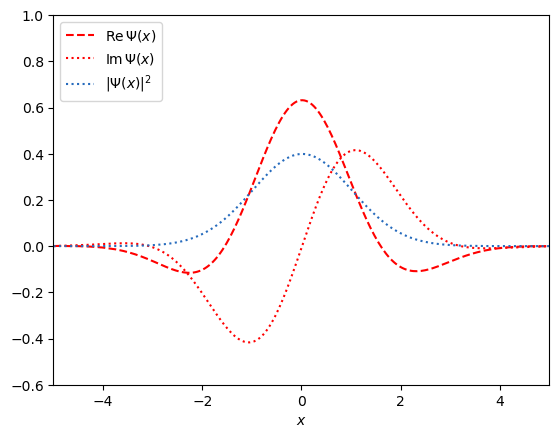

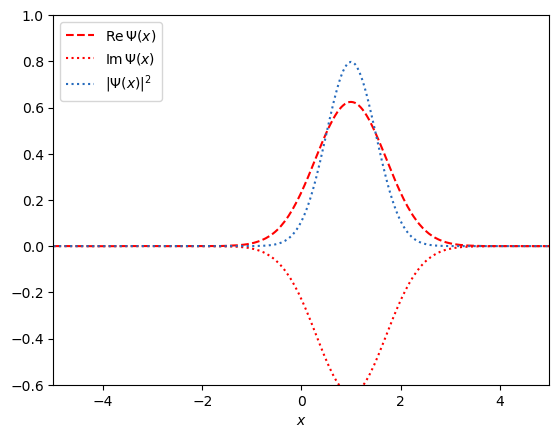

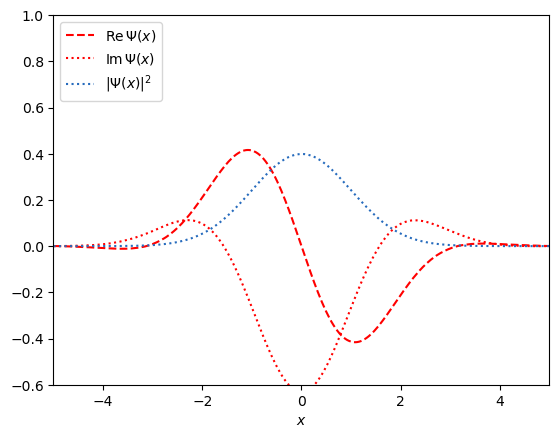

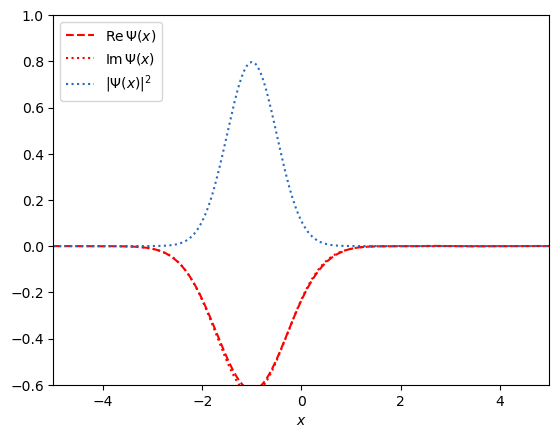

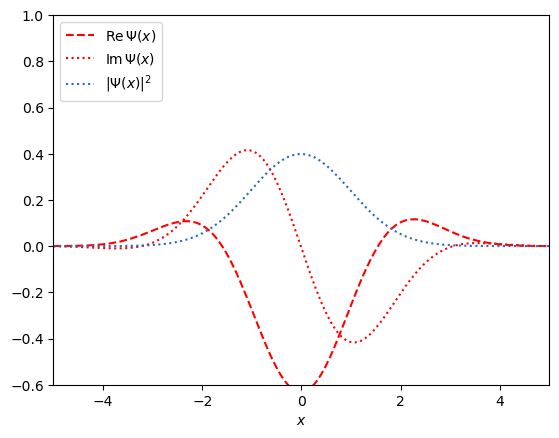

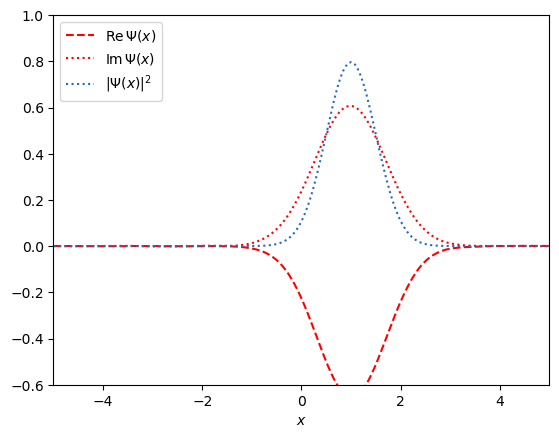

In [4]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Define the potential for the harmonic oscillator
def V(x):
    return 0.5 * x**2  # Let m = w = 1

# Define the spatial domain
N = 256                 # Number of grid points
x_domain = [-5.0, 5.0]  # Spatial domain

dx = (x_domain[1] - x_domain[0]) / (N-1)  # Define spatial step size
dt = 1.0 / 64.0  # Define temporal step size

x = np.linspace(x_domain[0], x_domain[1], N)  # Define spatial grid points

# Define the momentum domain
dp = 2*np.pi / (N*dx)   # Define momentum step size

p = np.linspace(0.0, (N-1)*dp, N)  # Define momentum grid points
p[p>0.5*N*dp] -= N*dp              # handle periodicity

# Initial Gaussian wave packet
d = np.sqrt(2.0)
k = 1.0
Psi = 1.0 / (np.pi**0.25 * np.sqrt(d)) * np.exp(-x**2.0 / (2.0 * d**2) + 1j * k * x)

# Construct the propagators/operators
U_1 = np.exp(-0.5*1j*V(x)*dt)
U_2 = np.exp(-1j*0.5*p**2*dt)

# Propagate 512 time steps
for l in range(0, 512):
    Psi *= U_1          # apply U_1 in real space
    Psi = np.fft.fft(Psi)   # go to Fourier space
    Psi *= U_2          # apply U_2 in Fourier space
    Psi = np.fft.ifft(Psi)  # go to real space
    Psi *= U_1          # apply U_1 in real space

    if l % 100 == 0:
        plt.clf()
        plt.plot(x, Psi.real, '--', color='r', label=r'$\mathrm{Re}\,\Psi(x)$')
        plt.plot(x, Psi.imag, ':', color='r', label=r'$\mathrm{Im}\,\Psi(x)$')
        plt.plot(x, Psi.real**2 + Psi.imag**2, ':', color='#266bbd', label=r'$|\Psi(x)|^2$')
        plt.gca().set_xlim(x_domain[0], x_domain[1])
        plt.gca().set_ylim(-0.6, 1)
        plt.xlabel(r'$x$')
        plt.legend(loc='upper left')
        plt.draw()
        plt.show()
        plt.pause(0.01)


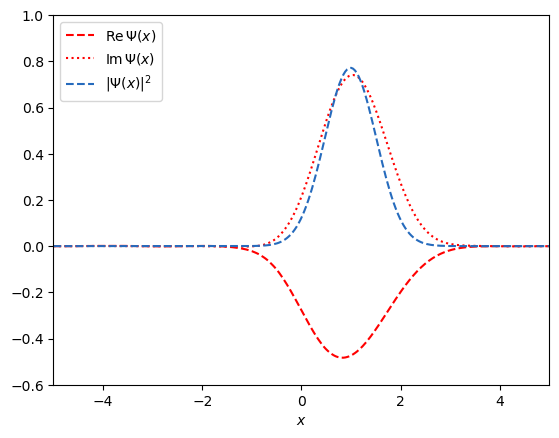

In [5]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Define the potential for the harmonic oscillator
def V(x):
    return 0.5 * x**2  # Let m = w = 1

# Define the spatial domain
N = 256                 # Number of grid points
x_domain = [-5.0, 5.0]  # Spatial domain

dx = (x_domain[1] - x_domain[0]) / (N-1)  # Define spatial step size
dt = 1.0 / 64.0  # Define temporal step size

x = np.linspace(x_domain[0], x_domain[1], N)  # Define spatial grid points

# Define the momentum domain
dp = 2*np.pi / (N*dx)   # Define momentum step size

p = np.linspace(0.0, (N-1)*dp, N)  # Define momentum grid points
p[p>0.5*N*dp] -= N*dp              # handle periodicity

# Initial Gaussian wave packet
d = np.sqrt(2.0)
k = 1.0
Psi = 1.0 / (np.pi**0.25 * np.sqrt(d)) * np.exp(-x**2.0 / (2.0 * d**2) + 1j * k * x)

# Construct the propagators/operators
U_1 = np.exp(-0.5*1j*V(x)*dt)
U_2 = np.exp(-1j*0.5*p**2*dt)

# Set up the figure and axis
fig, ax = plt.subplots()
ax.set_xlim(x_domain[0], x_domain[1])
ax.set_ylim(-0.6, 1.0)
ax.set_xlabel(r'$x$')

# Plot elements
line_real, = ax.plot([], [], "--r", label=r'$\mathrm{Re}\, \Psi(x)$')
line_imag, = ax.plot([], [], ":r", label=r'$\mathrm{Im}\, \Psi(x)$')
line_prob, = ax.plot([], [], "--", color="#266bbd", label=r'$|\Psi(x)|^2$')
ax.legend(loc='upper left')

# Initialization function
def init():
    line_real.set_data([], [])
    line_imag.set_data([], [])
    line_prob.set_data([], [])
    return line_real, line_imag, line_prob

# Update function
def update(frame):
    global Psi
    Psi *= U_1              # apply U_1 in real space
    Psi = np.fft.fft(Psi)   # go to Fourier space
    Psi *= U_2              # apply U_2 in Fourier space
    Psi = np.fft.ifft(Psi)  # go to real space
    Psi *= U_1              # apply U_1 in real space

    line_real.set_data(x, Psi.real)
    line_imag.set_data(x, Psi.imag)
    line_prob.set_data(x, Psi.real**2 + Psi.imag**2)

    return line_real, line_imag, line_prob

# Create animation
ani = animation.FuncAnimation(fig, update, frames=512, init_func=init, blit=True)

# Show the animation
# plt.show()
HTML(ani.to_jshtml())

# Klein Tunneling of a Dirac Wave Packet
### Time-dependent one-dimensional Dirac equation for a particle scattering at a potential via the Fourier split operator method

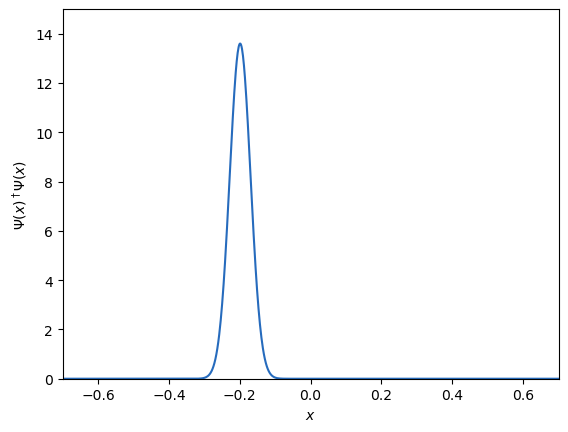

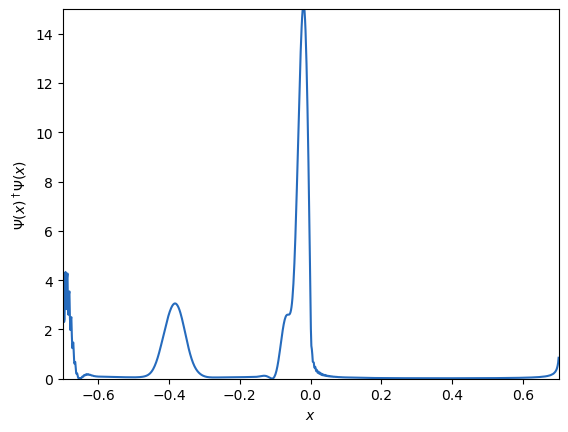

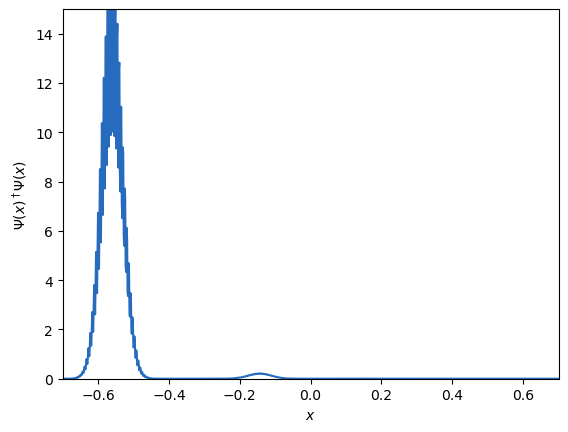

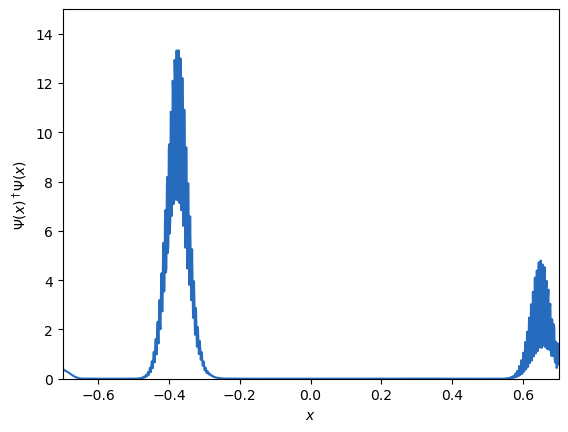

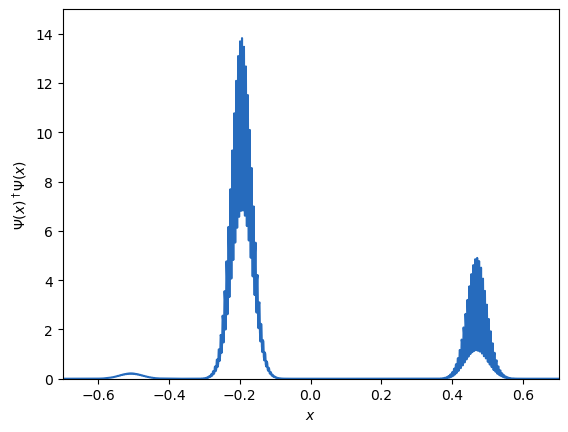

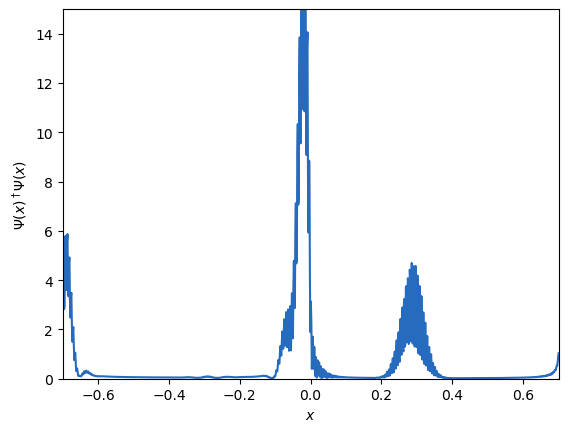

In [4]:
import numpy as np
import matplotlib.pyplot as plt

# Define the (smooth) step potential
# V(x)=0.5*V0*(tanh(x/w)+1)
def V(x, V0, w):
    return V0*0.5*(np.tanh(x/w)+1)

# Define computational grid
N = 1024
x_domain = [-0.7, 0.7]

dx = (x_domain[1] - x_domain[0]) / (N-1)     # spatial step size
x = np.linspace(x_domain[0], x_domain[1], N) # spatial grid points

c = 137                 # speed of light in atomic units (h=e=m_e=1)
dt = 1.0 / (4*c**2)     # temporal step size

dp = 2.0*np.pi / (N*dx)             # momentum step size
p = np.linspace(0, (N-1)*dp, N)     # momentum grid points
p[p>0.5*N*dp] -= N*dp               # imposing periodicity
p = np.sort(p)

# Initial wave packet
# Gaussian wave packet with p_mean composed of positive-energy states
x_init = -0.2               # initial position of the wave packet
p_mean = 106.4              # mean momentum
Delta_p = 0.125*c           # momentum width
p_0 = np.sqrt(p**2 + c**2)  # reduced energy
Psi = np.zeros((2,N), dtype='complex')
Psi[0, :] = 1
Psi[1, :] = p / (c+p_0)
Psi *= np.sqrt(0.5*(c+p_0)/p_0) # normalize
g = 1 / (2*np.pi*Delta_p**2)**0.25 * np.exp( -(p-p_mean)**2 / (4*Delta_p**2) - 1j*p*x_init)
Psi *= g    # multiply with weight function

# go to real space
Psi = dp / np.sqrt(2*np.pi) * np.exp(1j*x*p[0]) * np.fft.ifft(np.exp(1j*x[0]*np.arange(0, N)*dp)*Psi, axis=1)*N

# real space propagator
U_1 = np.exp(-0.5*1j*V(x, 2*c**2+1e4, 0.3/c)*dt)

# construct the free propagator
U_2 = np.zeros((2, 2, N), dtype='complex')
for i in range(0, N):
    Q = np.array([ [1, -p[i]/(c+p_0[i])], [p[i]/(c+p_0[i]), 1] ])
    Q *= np.sqrt(0.5*(c+p_0[i])/p_0[i])
    U_2[:, :, i] = np.dot(Q, np.dot(np.diag([np.exp(-1j*dt*c*p_0[i]), np.exp(+1j*dt*c*p_0[i])]), Q.T))

# propagate 512 time steps
for l in range(0, 512):
    Psi *= U_1                                      # apply U_1 in real space
    Psi = np.fft.fft(Psi, axis=1)                   # go to Fourier space
    Psi = np.einsum('ij...,j...->i...', U_2, Psi)   # apply U_2 in Fourier space
    Psi = np.fft.ifft(Psi, axis=1)                  # go to real space
    Psi *= U_1                                      # apply U_1 in real space
    
    if l % 100 == 0:
        plt.clf()
        plt.plot(x, Psi[0,:].real**2 + Psi[0,:].imag**2 + Psi[1,:].real**2 + Psi[1,:].imag**2, color='#266bbd', label=r'$|\Psi(x)|^2$')
        plt.gca().set_xlim(x_domain[0], x_domain[1])
        plt.gca().set_ylim(0, 15)
        plt.xlabel(r'$x$')
        plt.ylabel(r'$\Psi(x)^\dagger\Psi(x)$')
        plt.draw()
        plt.show()
        plt.pause(0.01)

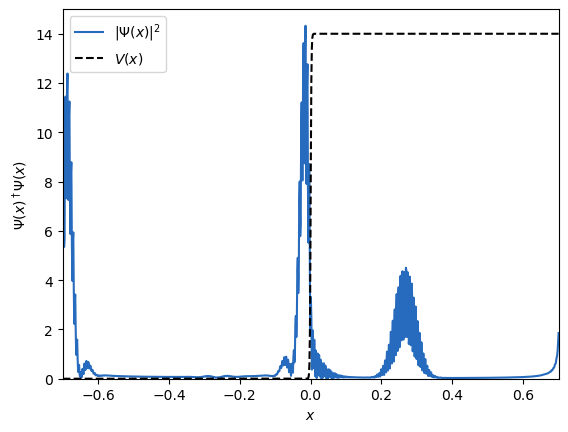

In [14]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Define the (smooth) step potential
# V(x)=0.5*V0*(tanh(x/w)+1)
def V(x, V0, w):
    return V0*0.5*(np.tanh(x/w)+1)

# Define computational grid
N = 1024
x_domain = [-0.7, 0.7]

dx = (x_domain[1] - x_domain[0]) / (N-1)     # spatial step size
x = np.linspace(x_domain[0], x_domain[1], N) # spatial grid points

c = 137                 # speed of light in atomic units (h=e=m_e=1)
dt = 1.0 / (4*c**2)     # temporal step size

dp = 2.0*np.pi / (N*dx)             # momentum step size
p = np.linspace(0, (N-1)*dp, N)     # momentum grid points
p[p>0.5*N*dp] -= N*dp               # imposing periodicity
p = np.sort(p)

# Initial wave packet
# Gaussian wave packet with p_mean composed of positive-energy states
x_init = -0.2               # initial position of the wave packet
p_mean = 106.4              # mean momentum
Delta_p = 0.125*c           # momentum width
p_0 = np.sqrt(p**2 + c**2)  # reduced energy
Psi = np.zeros((2,N), dtype='complex')
Psi[0, :] = 1
Psi[1, :] = p / (c+p_0)
Psi *= np.sqrt(0.5*(c+p_0)/p_0) # normalize
g = 1 / (2*np.pi*Delta_p**2)**0.25 * np.exp(-(p-p_mean)**2 / (4*Delta_p**2)) * np.exp(- 1j*p*x_init)
Psi *= g    # multiply with weight function

# go to real space
Psi = dp / np.sqrt(2*np.pi) * np.exp(1j*x*p[0]) * np.fft.ifft(np.exp(1j*x[0]*np.arange(0, N)*dp)*Psi, axis=1)*N

# real space propagator
U_1 = np.exp(-0.5*1j*V(x, 2*c**2+1e4, 0.3/c)*dt)

# construct the free propagator
U_2 = np.zeros((2, 2, N), dtype='complex')
for i in range(0, N):
    Q = np.array([ [1, -p[i]/(c+p_0[i])], [p[i]/(c+p_0[i]), 1] ])
    Q *= np.sqrt(0.5*(c+p_0[i])/p_0[i])
    U_2[:, :, i] = np.dot(Q, np.dot(np.diag([np.exp(-1j*dt*c*p_0[i]), np.exp(+1j*dt*c*p_0[i])]), Q.T))

# Define the potential barrier
V0 = 2 *c**2 + 1e4  # potential height
w = 0.3 / c          # potential width
V_x = V(x, V0, w)    # compute potential function

# Normalize V(x) for visualization (scaling factor for visibility)
V_x = V_x / np.max(V_x) * 14  # Scale to be within (0,5) for plotting

# Set up the figure and axis
fig, ax = plt.subplots()
ax.set_xlim(x_domain[0], x_domain[1])
ax.set_ylim(0, 15)
ax.set_xlabel(r'$x$')
ax.set_ylabel(r'$\Psi(x)^\dagger\Psi(x)$')

# Plot elements
line_prob, = ax.plot([], [], color="#266bbd", label=r'$|\Psi(x)|^2$')
ax.plot(x, V_x, color='black', linestyle='--', label=r'$V(x)$') # potential barrier
ax.legend(loc='upper left')

# Initialization function
def init():
    line_prob.set_data([], [])
    return line_prob,

# Update function
def update(frame):
    global Psi
    Psi *= U_1                                      # apply U_1 in real space
    Psi = np.fft.fft(Psi, axis=1)                   # go to Fourier space
    Psi = np.einsum('ij...,j...->i...', U_2, Psi)   # apply U_2 in Fourier space
    Psi = np.fft.ifft(Psi, axis=1)                  # go to real space
    Psi *= U_1                                      # apply U_1 in real space

    line_prob.set_data(x, Psi[0,:].real**2 + Psi[0,:].imag**2 + Psi[1,:].real**2 + Psi[1,:].imag**2)

    return line_prob,

# Create animation
ani = animation.FuncAnimation(fig, update, frames=512, init_func=init, blit=True)

# Show the animation
# plt.show()
HTML(ani.to_jshtml())